In [32]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

df = pd.read_csv("C:\\Users\\Aditi\\Desktop\\ML\\Mini Project\\Turbine_Data.csv")

In [33]:
df.tail()

,Unnamed: 0,ActivePower,AmbientTemperatue,BearingShaftTemperature,Blade1PitchAngle,Blade2PitchAngle,Blade3PitchAngle,ControlBoxTemperature,GearboxBearingTemperature,GearboxOilTemperature,...,GeneratorWinding2Temperature,HubTemperature,MainBoxTemperature,NacellePosition,ReactivePower,RotorRPM,TurbineStatus,WTG,WindDirection,WindSpeed
118219,2020-03-30 23:10:00+00:00,70.044465,27.523741,45.711129,1.515669,1.950088,1.950088,0.0,59.821165,55.193793,...,58.148777,39.008931,36.476562,178.0,13.775785,9.234004,2.0,G01,178.0,3.533445
118220,2020-03-30 23:20:00+00:00,40.833474,27.602882,45.598573,1.702809,2.136732,2.136732,0.0,59.142038,54.798545,...,57.550367,39.006759,36.328125,178.0,8.088928,9.229370,2.0,G01,178.0,3.261231
118221,2020-03-30 23:30:00+00:00,20.777790,27.560925,45.462045,1.706214,2.139664,2.139664,0.0,58.439439,54.380456,...,57.099335,39.003815,36.131944,178.0,4.355978,9.236802,2.0,G01,178.0,3.331839
118222,2020-03-30 23:40:00+00:00,62.091039,27.810472,45.343827,1.575352,2.009781,2.009781,0.0,58.205413,54.079014,...,56.847239,39.003815,36.007805,190.0,12.018077,9.237374,2.0,G01,190.0,3.284468
118223,2020-03-30 23:50:00+00:00,68.664425,27.915828,45.231610,1.499323,1.933124,1.933124,0.0,58.581716,54.080505,...,56.741040,39.003815,35.914062,203.0,14.439669,9.235532,2.0,G01,203.0,3.475205


In [34]:
# attribute not needed
df.drop('Unnamed: 0', axis=1, inplace=True)
df.drop('WTG', axis=1, inplace=True)

In [35]:
from sklearn.impute import SimpleImputer
#Removing Null Values using IMPUTER MEDIAN METHOD -
imputer = SimpleImputer(missing_values = np.nan, strategy ='median') 

# Fitting the data to the imputer object 
imputed_df = pd.DataFrame(imputer.fit_transform(df))
imputed_df.columns = df.columns
imputed_df.index = df.index

imputed_df.head()

,ActivePower,AmbientTemperatue,BearingShaftTemperature,Blade1PitchAngle,Blade2PitchAngle,Blade3PitchAngle,ControlBoxTemperature,GearboxBearingTemperature,GearboxOilTemperature,GeneratorRPM,GeneratorWinding1Temperature,GeneratorWinding2Temperature,HubTemperature,MainBoxTemperature,NacellePosition,ReactivePower,RotorRPM,TurbineStatus,WindDirection,WindSpeed
0,402.654893,28.340541,42.910877,0.394399,0.888977,0.888977,0.0,64.834662,57.196089,1124.86072,65.7888,65.004946,37.003815,39.49131,182.0,35.883659,10.098702,2.0,182.0,5.557765
1,402.654893,28.340541,42.910877,0.394399,0.888977,0.888977,0.0,64.834662,57.196089,1124.86072,65.7888,65.004946,37.003815,39.49131,182.0,35.883659,10.098702,2.0,182.0,5.557765
2,402.654893,28.340541,42.910877,0.394399,0.888977,0.888977,0.0,64.834662,57.196089,1124.86072,65.7888,65.004946,37.003815,39.49131,182.0,35.883659,10.098702,2.0,182.0,5.557765
3,402.654893,28.340541,42.910877,0.394399,0.888977,0.888977,0.0,64.834662,57.196089,1124.86072,65.7888,65.004946,37.003815,39.49131,182.0,35.883659,10.098702,2.0,182.0,5.557765
4,402.654893,28.340541,42.910877,0.394399,0.888977,0.888977,0.0,64.834662,57.196089,1124.86072,65.7888,65.004946,37.003815,39.49131,182.0,35.883659,10.098702,2.0,182.0,5.557765


In [36]:
from sklearn.preprocessing import RobustScaler, StandardScaler

rs = RobustScaler()
columns = imputed_df.columns.values.tolist()


preprocessed = rs.fit_transform(imputed_df[columns])
preprocessed = pd.DataFrame(preprocessed,columns=columns)



preprocessed.dtypes


ActivePower                     float64
AmbientTemperatue               float64
BearingShaftTemperature         float64
Blade1PitchAngle                float64
Blade2PitchAngle                float64
Blade3PitchAngle                float64
ControlBoxTemperature           float64
GearboxBearingTemperature       float64
GearboxOilTemperature           float64
GeneratorRPM                    float64
GeneratorWinding1Temperature    float64
GeneratorWinding2Temperature    float64
HubTemperature                  float64
MainBoxTemperature              float64
NacellePosition                 float64
ReactivePower                   float64
RotorRPM                        float64
TurbineStatus                   float64
WindDirection                   float64
WindSpeed                       float64
dtype: object

In [37]:
def accuracy(predicted, observed):
    mse = abs(predicted - observed).mean()      # MSE, Mean Square Error
    rmse = (mse)**0.5#((predicted - observed)**2).mean()**.5  # RMSE, Root Mean Square Error
    mae = abs(predicted - observed).mean()      # MAE, Mean Absolute Error
    mape = abs((predicted - observed)/observed).mean()  # MAPE, Mean Absolute Percentage Error
    smape = (abs(predicted - observed)/((abs(predicted)+abs(observed))/2)).mean() # SMAPE, Symmetric Mean Absolute Percentage Error

    return({'MSE, Mean Square Error': mse, 
            'RMSE, Root Mean Square Error':rmse, 
            'MAE, Mean Absolute Error': mae, 
            'MAPE, Mean Absolute Percentage Error': mape , 
            'SMAPE, Symmetric Mean Absolute Percentage Error':smape})

In [38]:
# Decision Tree Regressor

In [39]:
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import train_test_split


column_list = ['ActivePower', 'AmbientTemperatue', 'BearingShaftTemperature',
       'Blade1PitchAngle', 'Blade2PitchAngle', 'Blade3PitchAngle',
       'GearboxBearingTemperature', 'GearboxOilTemperature', 'GeneratorRPM',
       'GeneratorWinding1Temperature', 'GeneratorWinding2Temperature',
       'HubTemperature', 'MainBoxTemperature', 'NacellePosition',
       'ReactivePower', 'RotorRPM', 'WindDirection']

x = preprocessed[column_list]

y = preprocessed['WindSpeed']

train_x, test_x, train_y, test_y = train_test_split(x, y, test_size=0.33, random_state=100)

model = DecisionTreeRegressor().fit(train_x,train_y)
predict_y = model.predict(test_x)


for i in range(len(column_list)):
    print('%s: %.5f'%(column_list[i],model.feature_importances_[i]))

ActivePower: 0.91650
AmbientTemperatue: 0.01045
BearingShaftTemperature: 0.00366
Blade1PitchAngle: 0.02323
Blade2PitchAngle: 0.00516
Blade3PitchAngle: 0.00180
GearboxBearingTemperature: 0.00175
GearboxOilTemperature: 0.00239
GeneratorRPM: 0.00241
GeneratorWinding1Temperature: 0.00281
GeneratorWinding2Temperature: 0.00528
HubTemperature: 0.00230
MainBoxTemperature: 0.00190
NacellePosition: 0.00273
ReactivePower: 0.00948
RotorRPM: 0.00102
WindDirection: 0.00713


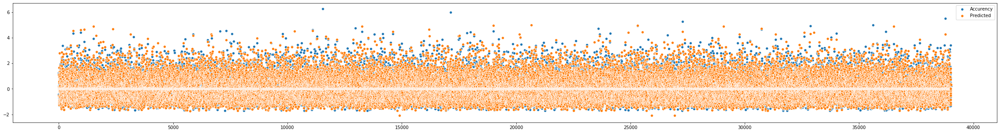

In [40]:
x = range(len(predict_y))
y1 = test_y.values
y2 = predict_y


plt.figure(figsize=(40,5))
sns.scatterplot(x=x, y=y1, legend= 'full')
sns.scatterplot(x=x, y=y2, legend= 'full')
plt.legend(['Accurency','Predicted'])
plt.show()

In [41]:
accuracy(y2, y1)

{'MSE, Mean Square Error': 0.11173857047189338,
 'RMSE, Root Mean Square Error': 0.33427319735792965,
 'MAE, Mean Absolute Error': 0.11173857047189338,
 'MAPE, Mean Absolute Percentage Error': nan,
 'SMAPE, Symmetric Mean Absolute Percentage Error': nan}

In [42]:
# Linear Regressor

In [43]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import confusion_matrix
x = preprocessed[column_list]

y = preprocessed['WindSpeed']

train_x, test_x, train_y, test_y = train_test_split(x, y, test_size=0.33, random_state=100)

model = LinearRegression().fit(train_x, train_y)
predict_y = model.predict(test_x)

for i in range(len(column_list)):
    print('%s: %.5f'%(column_list[i], model.coef_[i]))

ActivePower: 0.98963
AmbientTemperatue: -0.05184
BearingShaftTemperature: -0.03741
Blade1PitchAngle: -0.00240
Blade2PitchAngle: 8354944135.78979
Blade3PitchAngle: -8354944135.78928
GearboxBearingTemperature: 0.02245
GearboxOilTemperature: 0.00190
GeneratorRPM: 0.00527
GeneratorWinding1Temperature: -0.01318
GeneratorWinding2Temperature: 0.01106
HubTemperature: 0.00257
MainBoxTemperature: 0.00908
NacellePosition: -5916944619.12111
ReactivePower: -0.01142
RotorRPM: 0.00213
WindDirection: 5916944619.12168


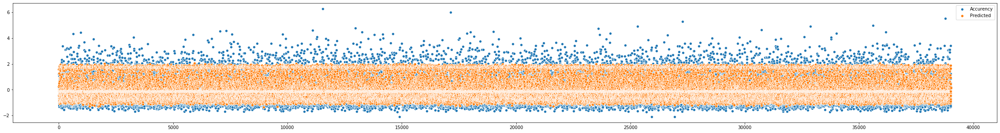

In [44]:
x = range(len(predict_y))
y1 = test_y.values
y2 = predict_y


plt.figure(figsize=(40,5))
sns.scatterplot(x=x, y=y1, legend= 'full')
sns.scatterplot(x=x, y=y2, legend= 'full')
plt.legend(['Accurency','Predicted'])
plt.show()

In [45]:
accuracy(y2, y1)

{'MSE, Mean Square Error': 0.20047230646509187,
 'RMSE, Root Mean Square Error': 0.44774133879405403,
 'MAE, Mean Absolute Error': 0.20047230646509187,
 'MAPE, Mean Absolute Percentage Error': inf,
 'SMAPE, Symmetric Mean Absolute Percentage Error': 0.7413635121180768}

In [46]:
# ensemble
import pandas as pd

from sklearn.metrics import accuracy_score
from sklearn.svm import SVC
from sklearn.ensemble import VotingRegressor
from sklearn.metrics import r2_score, mean_squared_error


In [47]:
X = preprocessed[column_list]
Y = preprocessed['WindSpeed']

estimators = []

model2 = DecisionTreeRegressor()
estimators.append(('cart', model2))

model3 = LinearRegression()
estimators.append(('LR', model3))

ensemble = VotingRegressor(estimators)
eclf1 = ensemble.fit(X, Y)
y1 = eclf1.predict(X)
mse=mean_squared_error(Y,y1)
rootmse=np.sqrt(mse)
print(rootmse)

0.16040953287299284


In [48]:
# load libraries
from sklearn.ensemble import AdaBoostRegressor



# create adaboost classifier object
abc = AdaBoostRegressor(n_estimators=50, base_estimator=DecisionTreeRegressor())

# train adaboost classifier
model = abc.fit(X, Y)

# predict the respose for test dataset
y_pred = model.predict(X)

# model accuracy to show how often the classifier is correct
print("Accuracy:", mean_squared_error(Y, y_pred))

Accuracy: 0.004513862134669218


In [49]:
imputed_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 118224 entries, 0 to 118223
Data columns (total 20 columns):
ActivePower                     118224 non-null float64
AmbientTemperatue               118224 non-null float64
BearingShaftTemperature         118224 non-null float64
Blade1PitchAngle                118224 non-null float64
Blade2PitchAngle                118224 non-null float64
Blade3PitchAngle                118224 non-null float64
ControlBoxTemperature           118224 non-null float64
GearboxBearingTemperature       118224 non-null float64
GearboxOilTemperature           118224 non-null float64
GeneratorRPM                    118224 non-null float64
GeneratorWinding1Temperature    118224 non-null float64
GeneratorWinding2Temperature    118224 non-null float64
HubTemperature                  118224 non-null float64
MainBoxTemperature              118224 non-null float64
NacellePosition                 118224 non-null float64
ReactivePower                   118224 non-null f

In [50]:
imputed_df['ActivePower'].unique()

array([402.65489332,  -5.3577271 ,  -5.82236038, ...,  20.77778972,
        62.09103858,  68.66442478])

In [51]:
# Clustering

In [56]:
import numpy as np 
import pandas as pd
import matplotlib.pyplot as plt

df = pd.read_csv("C:\\Users\\Aditi\\Desktop\\ML\\Mini Project\\Turbine_Data.csv")
df.drop('Unnamed: 0', axis=1, inplace=True)
df.drop('WTG', axis=1, inplace=True)

from sklearn.impute import SimpleImputer
#Removing Null Values using IMPUTER MEDIAN METHOD -
imputer = SimpleImputer(missing_values = np.nan, strategy ='median') 

# Fitting the data to the imputer object 
imputed_df = pd.DataFrame(imputer.fit_transform(df))
imputed_df.columns = df.columns
imputed_df.index = df.index

# data is clusters as per the score in various subjects
scores = imputed_df.loc[100:,["TurbineStatus","WindDirection","WindSpeed"]] 

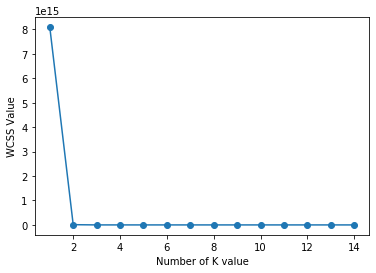

In [57]:
from sklearn.cluster import KMeans

wcss = []
for i in range(1,15):
    kmeans = KMeans(n_clusters=i)
    kmeans.fit(scores)
    wcss.append(kmeans.inertia_)

plt.plot(range(1,15),wcss,"-o")
plt.xlabel("Number of K value")
plt.ylabel("WCSS Value")
plt.show()

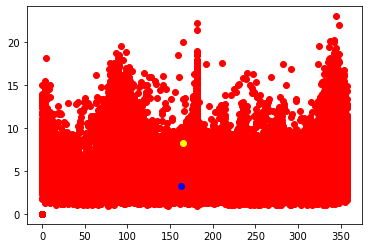

In [54]:
kmeans = KMeans(n_clusters = 3)
clusters = kmeans.fit_predict(scores)
scores["examscores"] = clusters


plt.scatter(
    scores.WindDirection[scores.examscores == 0], 
    scores.WindSpeed[scores.examscores == 0],
    color="red")
plt.scatter(
    scores.WindDirection[scores.examscores == 1], 
    scores.WindSpeed[scores.examscores == 1],
    color="blue")
plt.scatter(
    scores.WindDirection[scores.examscores == 2], 
    scores.WindSpeed[scores.examscores == 2],
    color="yellow")
plt.show()